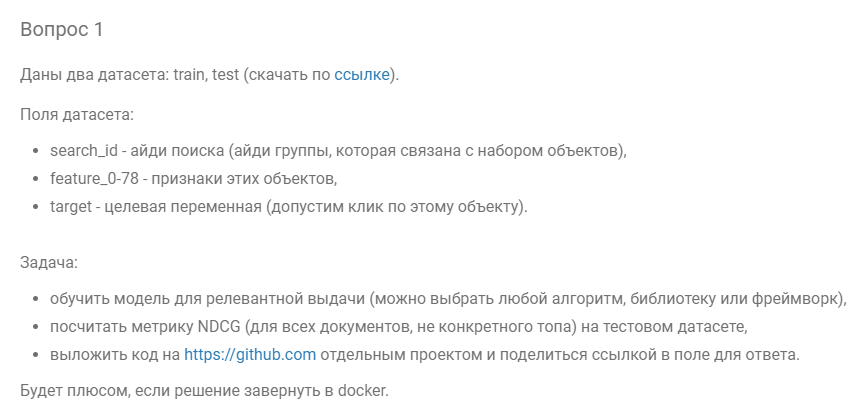

Скачаем нужные библиотеки

In [241]:
!pip install dataprep
!pip install verstack
!pip install imbalanced-learn

Импортируем библиотеки

In [242]:
from google.colab import files
import pandas as pd
from dataprep.eda import create_report
import seaborn as sns
from verstack import FeatureSelector
from sklearn.utils import shuffle
import xgboost as xgb
from sklearn.metrics import ndcg_score
import numpy as np
from sklearn.neural_network import MLPClassifier
import joblib
import imblearn

Скачаем файлы

In [111]:
uploaded = files.upload()

Загрузим в среду данные и сразу избавимся от константных колонок

In [264]:
def check_distrubution(dataframe, threshold=1, count=1):
  assert len(dataframe) >= count

  transformed_dataframe = dataframe.copy()
  for column in dataframe.columns:
    freq = dataframe[column].value_counts()/len(dataframe[column])
    sum = 0
    for i in range(count):
      sum += freq.values[i]
      if sum >= threshold:
        transformed_dataframe.drop(column,axis=1,inplace=True)
        print(f"I've dropped {column}")
        break
  return transformed_dataframe

train_df = check_distrubution(pd.read_csv("train_df.csv"))
test_df = check_distrubution(pd.read_csv("test_df.csv"))

I've dropped feature_0
I've dropped feature_73
I've dropped feature_74
I've dropped feature_75
I've dropped feature_0
I've dropped feature_73
I've dropped feature_74
I've dropped feature_75


Сформируем автоматический репорт

DataPrep Report
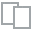
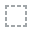
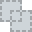
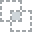
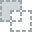
...
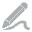
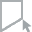
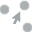
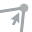
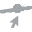

In [266]:
create_report(train_df)

Заметка - Если вглянуть на target, то можно увидеть, что он представлен двумя неравномерное распредлёнными величинами, в купе с распределениями других величин, это заставляет задавать вопросы. Но опредлённо точно не стоит кормить модель всеми колонками, среди них есть вообще константные (функция check distribution, говорит что это колонки 0, 73, 74 и 75). Особенно выделим фичи [['feature_53','feature_54','feature_55','feature_63','feature_70']]

А теперь проведём корреляционный анализ, но для удобства я отсортирую колонки по корреляции.

     feature_70  feature_67  feature_66  feature_51  feature_4  feature_3  \
0      0.226789    0.401521    0.012159    0.043588          9          0   
1      0.264210    0.436360    0.922468    0.043065         20          1   
2      0.208184    0.584387    0.171832    0.061392          9          0   
3      0.191760    0.284508    0.000000    0.039784          9          0   
4      0.000000    0.500000    0.000000    0.050165         20          1   
..          ...         ...         ...         ...        ...        ...   
639    0.200747    0.415929    0.853311    0.101617         20          1   
640    0.241641    0.372754    0.283679    0.047722         20          1   
641    0.290943    0.488859    0.170183    0.055502          9          0   
642    0.361866    0.665577    0.013156    0.048859          9          0   
643    0.294564    0.708367    0.011549    0.049388          9          0   

     feature_72  feature_48  feature_39  feature_76  ...  feature_21  \
0  


  0%|          | 0/19380 [00:00<?, ?it/s]
Computing apply-6247ba4eb4834969987411e2b393d523:   0%|          | 0/19380 [00:00<?, ?it/s]
Computing apply-6247ba4eb4834969987411e2b393d523:   0%|          | 0/19380 [00:00<?, ?it/s]
Computing drop-duplicates-chunk-344738d169f4e53438dd0a55f6e032a1-d4c522d1d9bb228dd4350c099eb98a87:   0%|          | 14/19380 [00:00<02:28, 130.66it/s]
Computing loc-series-sum-chunk-series-sum-agg-32ba27fbb9d66f8a8a5010b5503f675e:   1%|▏         | 279/19380 [00:00<00:12, 1492.40it/s]                 
Computing dropna-d7cb397913460fa4746c4b2e3e9efa92:   3%|▎         | 585/19380 [00:00<00:12, 1456.54it/s]                             
Computing finalize-3b4f37df-f922-4e4c-8f3c-82aa224a51d9:   4%|▍         | 766/19380 [00:00<00:12, 1490.62it/s]
Computing finalize-641c4658-9cc0-4af2-9c84-203244b277d7:   5%|▌         | 982/19380 [00:00<00:11, 1624.96it/s]
Computing ks_2samp-586b53c05aea8f0d0ab87230a8c9bb7a:   6%|▌         | 1161/19380 [00:00<00:11, 1627.15it/s]   
Comp

DataPrep Report
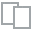
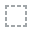
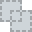
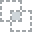
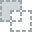
...
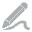
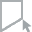
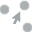
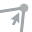
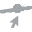

In [392]:
undersample = imblearn.under_sampling.RandomUnderSampler(sampling_strategy='majority')
X, y = undersample.fit_resample(train_df.drop(['target'],axis=1), train_df['target'])

# подготовим датасет, предположим, что X и y содержат данные
data = pd.concat([X, y], axis=1)

# рассчитаем матрицу корреляций
correlation_matrix = data.corr()
# корреляция между таргетом и колонками
column_target = abs(correlation_matrix.loc['target'])

best_columns = column_target.sort_values(ascending=False).index.to_numpy()[1::]
corr_df = X[best_columns].assign(target=y)
print(corr_df)
create_report(corr_df)

Попробуем бустинг на полной выборке

In [403]:
undersample = imblearn.under_sampling.RandomUnderSampler(sampling_strategy='majority')
X, y = undersample.fit_resample(train_df.drop(['target'],axis=1), train_df['target'])

model = xgb.XGBClassifier(eval_metric=ndcg_score)
model.fit(X, y)

clean_test_df = test_df.copy()[list(X.columns.values)+['target']]
X_test = clean_test_df.drop('target',axis=1)
y_test = clean_test_df['target']
y_pred = model.predict(X_test)

ndcg = ndcg_score([y_test], [y_pred])
print("NDCG Score:", ndcg)

NDCG Score: 0.4329108736294724


А теперь бустинг при выборе заранее отобранных фич - 70,67,66,51,4,72,48,39,10,38,63,41,16

In [472]:
undersample = imblearn.under_sampling.RandomUnderSampler(sampling_strategy='majority')
X, y = undersample.fit_resample(train_df.drop(['target'],axis=1), train_df['target'])

X = X[['feature_70','feature_67','feature_66','feature_51','feature_4','feature_72','feature_48','feature_39','feature_10','feature_38','feature_63','feature_41','feature_16']]

model = xgb.XGBClassifier(eval_metric=ndcg_score)
model.fit(X, y)

clean_test_df = test_df.copy()[list(X.columns.values)+['target']]
X_test = clean_test_df.drop('target',axis=1)
y_test = clean_test_df['target']
y_pred = model.predict(X_test)

ndcg = ndcg_score([y_test], [y_pred])
print("NDCG Score:", ndcg)

NDCG Score: 0.4233641270090397


Перебор - 513 и метрика 0.45, лучше не смог получить

In [460]:
random_state = -1
best_score = 0
while best_score < 0.5:
  random_state += 1
  undersample = imblearn.under_sampling.RandomUnderSampler(sampling_strategy='majority',random_state=random_state)
  X, y = undersample.fit_resample(train_df.drop(['target'],axis=1), train_df['target'])

  X = X[['feature_70','feature_67','feature_66','feature_51','feature_4','feature_72','feature_48','feature_39','feature_10','feature_38','feature_63','feature_41','feature_16']]

  print(random_state)
  model = xgb.XGBClassifier(eval_metric=ndcg_score)
  model.fit(X, y)

  clean_test_df = test_df.copy()[list(X.columns.values)+['target']]
  X_test = clean_test_df.drop('target',axis=1)
  y_test = clean_test_df['target']
  y_pred = model.predict(X_test)

  ndcg = ndcg_score([y_test], [y_pred])
  print("NDCG Score:", ndcg)

print(random_state)

0
NDCG Score: 0.425609885739756
1
NDCG Score: 0.4374438694893734
2
NDCG Score: 0.42892389225053784
3
NDCG Score: 0.4305569430167144
4
NDCG Score: 0.43429822086823144
5
NDCG Score: 0.4379731643394374
6
NDCG Score: 0.44229178868847185
7
NDCG Score: 0.4334922781958265
8
NDCG Score: 0.42690613301557456
9
NDCG Score: 0.4304311784742882
10
NDCG Score: 0.43575693649633807
11
NDCG Score: 0.4400028608642596
12
NDCG Score: 0.4343298232475116
13
NDCG Score: 0.43116310466419183
14
NDCG Score: 0.44014076241413846
15
NDCG Score: 0.42746482387383694
16
NDCG Score: 0.42722939523651776
17
NDCG Score: 0.43140745717769385
18
NDCG Score: 0.44739355337825404
19
NDCG Score: 0.4365292911999393
20
NDCG Score: 0.42983829900445925
21
NDCG Score: 0.43264809850824976
22
NDCG Score: 0.44042921544911456
23
NDCG Score: 0.4364018056929383
24
NDCG Score: 0.429011666984538
25
NDCG Score: 0.43707573283148615
26
NDCG Score: 0.4318076851082887
27
NDCG Score: 0.4337845069441473
28
NDCG Score: 0.4409804856889777
29
NDCG Sco

KeyboardInterrupt: 

А теперь при всех фичах, но заменим нули средним

In [287]:
undersample = imblearn.under_sampling.RandomUnderSampler(sampling_strategy='majority')
X, y = undersample.fit_resample(train_df.drop(['target'],axis=1), train_df['target'])

for column in X.columns:
  X[column] = X[column].replace(0,X[column].mean())

model = xgb.XGBClassifier(eval_metric=ndcg_score)
model.fit(X, y)

clean_test_df = test_df.copy()[list(X.columns.values)+['target']]
X_test = clean_test_df.drop('target',axis=1)
y_test = clean_test_df['target']
y_pred = model.predict(X_test)

ndcg = ndcg_score([y_test], [y_pred])
print("NDCG Score:", ndcg)

NDCG Score: 0.43846564202243715


А теперь при выделенных фичах и произведём замену

In [471]:
undersample = imblearn.under_sampling.RandomUnderSampler(sampling_strategy='majority')
X, y = undersample.fit_resample(train_df.drop(['target'],axis=1), train_df['target'])

X = X[['feature_70']]
for column in X.columns:
  X[column] = X[column].replace(0,X[column].mean())

model = xgb.XGBClassifier(eval_metric=ndcg_score)
model.fit(X, y)

clean_test_df = test_df.copy()[list(X.columns.values)+['target']]
X_test = clean_test_df.drop('target',axis=1)
y_test = clean_test_df['target']
y_pred = model.predict(X_test)

ndcg = ndcg_score([y_test], [y_pred])
print("NDCG Score:", ndcg)

NDCG Score: 0.4275578044788698


Лучший результат

In [473]:
undersample = imblearn.under_sampling.RandomUnderSampler(sampling_strategy='majority',random_state=513)
X, y = undersample.fit_resample(train_df.drop(['target'],axis=1), train_df['target'])

X = X[['feature_70','feature_67','feature_66','feature_51','feature_4','feature_72','feature_48','feature_39','feature_10','feature_38','feature_63','feature_41','feature_16']]

model = xgb.XGBClassifier(eval_metric=ndcg_score)
model.fit(X, y)

clean_test_df = test_df.copy()[list(X.columns.values)+['target']]
X_test = clean_test_df.drop('target',axis=1)
y_test = clean_test_df['target']
y_pred = model.predict(X_test)

ndcg = ndcg_score([y_test], [y_pred])
print("NDCG Score:", ndcg)

NDCG Score: 0.45657988772396635


Теперь для docker файла выделим какие колонки мы будем использовать и сохраним модель

In [474]:
columns = list(X.columns.values)+['target']
print(columns)
joblib.dump(model, 'rangemodel.pkl')
print("Model saved!")

['feature_70', 'feature_67', 'feature_66', 'feature_51', 'feature_4', 'feature_72', 'feature_48', 'feature_39', 'feature_10', 'feature_38', 'feature_63', 'feature_41', 'feature_16', 'target']
Model saved!
